## Hum2Guitar

### Synthesized Output Examples

In [1]:
import torch
import pickle
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa
import os
os.chdir('../source')
from dataset import preprocessing
from args import mel_kwargs, stft_kwargs
from utils.vis import plot_sample
from utils.env import create_folder
from model import GlobalGenerator, LocalEnhancer
from synthesis import hum_to_guitar
import torch.nn as nn
import numpy as np
import soundfile as sf
from utils.normalize import denormalize

### Dataset Directory

In [2]:
GUITAR_DIR = '~/GuitarSet/audio_mono-mic/'
HUMMING_DIR= '~/sample_hum/'

### Load Pre-trained Model

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
local_dict = torch.load("../output/checkpoint/checkpoint_local.tar", map_location=device)
net_GG = GlobalGenerator(gin_dim=1).to(device)
net_LE = LocalEnhancer(input_dim=1,
                       global_generator=nn.Sequential(*[getattr(net_GG, k) for k in ['down', 'res', 'up']])).to(device)
net_LE.load_state_dict(local_dict['net_G'])

<All keys matched successfully>

In [4]:
create_folder('../output/img/')
create_folder('../output/wav/')

## Let's Hum 🎤
### 1. My Humming Voice

#### Input Preprocessing

In [5]:
sr=22050
sig, sr = librosa.load('../../sample_hum/ex.wav', sr=sr)
h,x, db_mm= preprocessing(sig=sig, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type='humming')
h = h.to(device)
x = x.to(device)

#### Reconstructing the audio from Synthesized Mel Spectrogram

In [6]:
sig_h, h_ = hum_to_guitar(h, net_LE, db_mm, stft_kwargs=stft_kwargs, mel_kwargs=mel_kwargs, return_mel=True)
sf.write(f'../output/wav/humming_sample_wav_ex.wav', sig_h, sr, format='WAV', endian='LITTLE', subtype='PCM_16')

#### Visualization

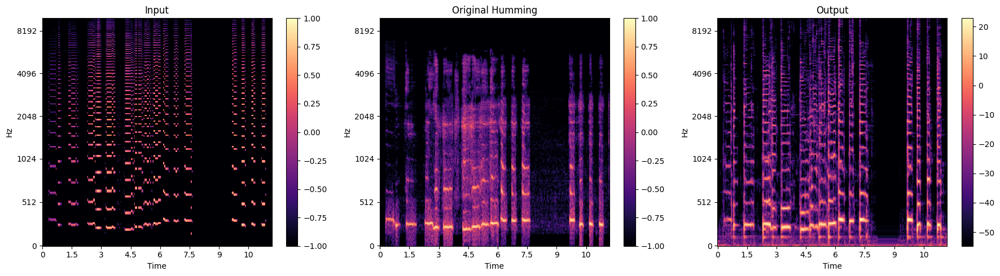

In [7]:
fig = plot_sample(h, x, y= librosa.power_to_db(h_), mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type='humming')
fig.savefig('../output/img/humming_sample_img_ex.jpg')

#### Play Audio

##### Input Humming Sound

In [8]:
ipd.Audio(sig, rate=sr)

##### Synthesized Guitar Sound

In [9]:
ipd.Audio(sig_h, rate=sr)

## 2. Examples with MTG-QBH Dataset

In [10]:
def show_hum2guitar(fn, device, stft_kwargs, mel_kwargs, input_type='humming', sr=22050, save=True):
    fn_ = fn.split('/')[-1].split('.')[0]
    sig, sr = librosa.load(fn, sr=sr)
    h,x, db_mm= preprocessing(sig=sig, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs)
    
    h = h.to(device)
    x = x.to(device)
    
    sig_h, h_ = hum_to_guitar(h, net_LE, db_mm, stft_kwargs=stft_kwargs, mel_kwargs=mel_kwargs, return_mel=True)
    
    ## Image
    fig = plot_sample(h, x, y= librosa.power_to_db(h_), mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type=input_type)
    if save:
        fig.savefig(f'../output/img/{input_type}_sample_{fn_}.jpg')
    
    ## Audio
    print('Input Audio Sound')
    ipd.display(ipd.Audio(sig, rate=sr))
    
    if input_type == "guitar":
        ## Reconstruction from Real Guitar Mel Spectrogram
        print("Audio from Real Guitar Mel Spectrogram")
        x_ = denormalize(x.detach().cpu().numpy(), db_mm)
        x_ = librosa.db_to_power(x_)
        sig_x = librosa.feature.inverse.mel_to_audio(x_,
                                                 center=True,
                                                 n_fft=stft_kwargs['n_fft'],hop_length=stft_kwargs['hop_length'], win_length=stft_kwargs['win_length'],
                                                 fmax=mel_kwargs['fmax'], fmin=mel_kwargs['fmin']
                                                 )
        ipd.display(ipd.Audio(sig_h, rate=sr))
        if save:
            sf.write(f'../output/wav/{input_type}_recon_{fn_}.wav', sig_h, sr, format='WAV', endian='LITTLE', subtype='PCM_16')
        
    
    print('Synthesized Guitar Sound')
    ipd.display(ipd.Audio(sig_h, rate=sr))
    if save:
        sf.write(f'../output/wav/{input_type}_sample_{fn_}.wav', sig_h, sr, format='WAV', endian='LITTLE', subtype='PCM_16')
    

Input Audio Sound


Synthesized Guitar Sound


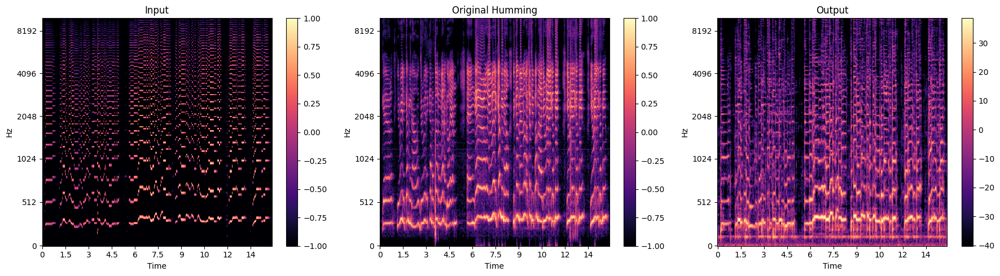

In [11]:
show_hum2guitar('../../sample_hum/q116.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs)

Input Audio Sound


Synthesized Guitar Sound


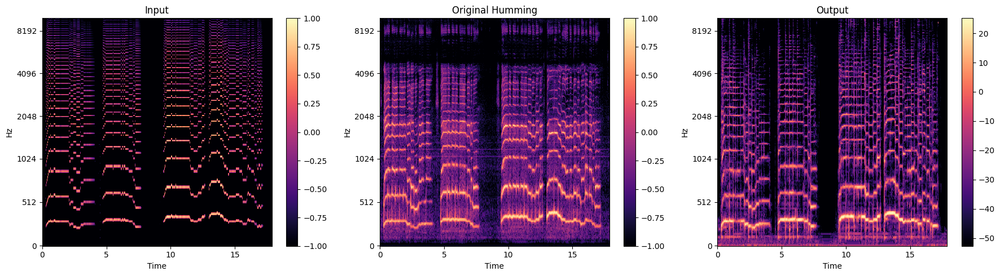

In [12]:
show_hum2guitar('../../sample_hum/q9.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs)

Input Audio Sound


Synthesized Guitar Sound


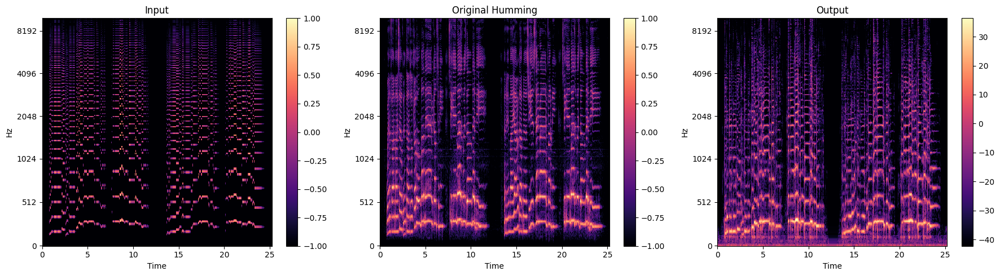

In [13]:
show_hum2guitar('../../sample_hum/q66.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs)

Input Audio Sound


Synthesized Guitar Sound


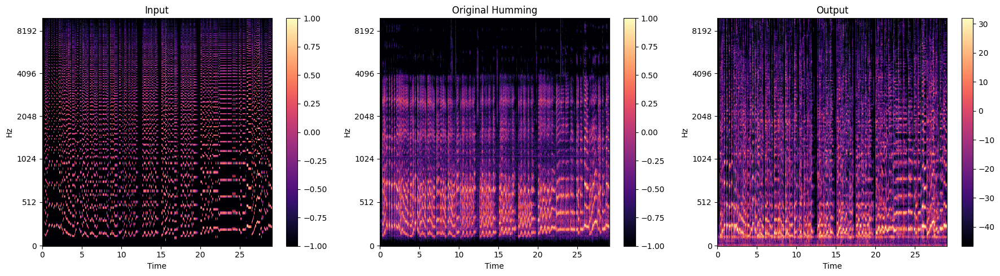

In [14]:
show_hum2guitar('../../sample_hum/q107.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs)

## 3. GuitarSet Samples
* We can guess on how well the model can accurately restore from semantic harmonics based on these examples.
* It may be seen that the phase information occupies an important part in recognizing the timbre of guitar.

Input Audio Sound


Audio from Real Guitar Mel Spectrogram


Synthesized Guitar Sound


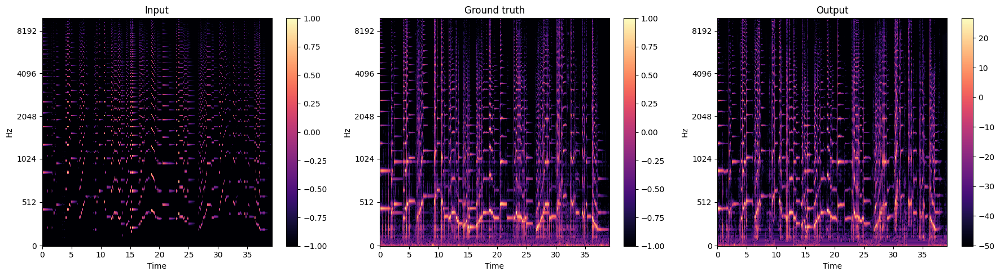

In [15]:
show_hum2guitar('../../GuitarSet/audio_mono-mic/05_SS3-98-C_solo_mic.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type='guitar')

Input Audio Sound


Audio from Real Guitar Mel Spectrogram


Synthesized Guitar Sound


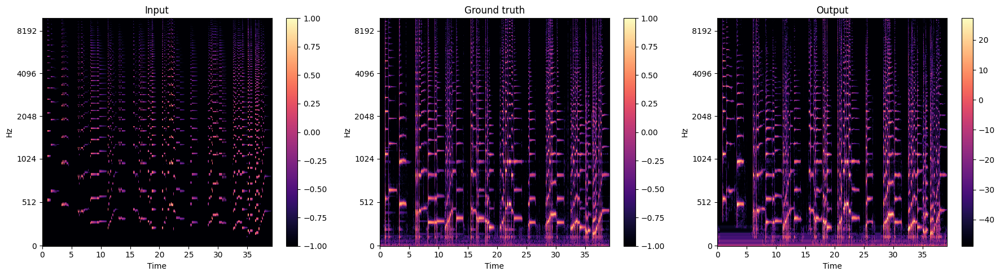

In [16]:
show_hum2guitar('../../GuitarSet/audio_mono-mic/05_Funk3-98-A_solo_mic.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type='guitar')

In [ ]:
show_hum2guitar('../../GuitarSet/audio_mono-mic/00_Rock2-142-D_solo_mic.wav', device=device, mel_kwargs=mel_kwargs, stft_kwargs=stft_kwargs, input_type='guitar')

Input Audio Sound


Audio from Real Guitar Mel Spectrogram


Synthesized Guitar Sound
